# Get a set of basemaps


In [47]:
from shapely.geometry import Polygon, box
%matplotlib inline 
import matplotlib.pyplot as plt
import contextily as ctx
from pyproj import CRS
import geopandas as gpd
plt.rcParams['figure.figsize'] = [20, 10]

In [50]:
ABQ_BB_COORDS = [
         (-106.751404, 35.024374),
         (-106.751404, 35.227111),
         (-106.451340, 35.227111),
         (-106.451340, 35.024374),
]

poly = Polygon(ABQ_BB_COORDS)

abq = gpd.GeoDataFrame(geometry=[poly])

abq = abq.set_crs(CRS.from_epsg(4269))
abq.to_file("../../data/local/abq_shp.gpkg", driver='GPKG', layer='base')
abq.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [3]:
west, south, east, north = bbox = abq.total_bounds
bbox

array([-106.751404,   35.024374, -106.45134 ,   35.227111])

In [44]:
providers = [
    (ctx.providers.OpenTopoMap, "../../images/abq_oto.tif"),
    (ctx.providers.OpenStreetMap.Mapnik, "../../images/abq_osm_mn.tif"), 
    (ctx.providers.OpenStreetMap.HOT, "../../images/abq_hot.tif"),
    (ctx.providers.CartoDB.Positron, "../../images/abq_cdbp.tif"),
    (ctx.providers.CartoDB.Voyager, "../../images/abq_cdbv.tif"),
    (ctx.providers.Esri.NatGeoWorldMap, "../../images/abq_ngwm.tif"),
    (ctx.providers.Esri.WorldPhysical, "../../images/abq_esri_wp.tif"),
    (ctx.providers.Esri.WorldStreetMap, "../../images/abq_esri_ws.tif"),
    (ctx.providers.Esri.WorldImagery, "../../images/abq_esri_wi.tif"),
    (ctx.providers.Esri.WorldTerrain, "../../images/abq_esri_wt.tif"),
    (ctx.providers.Esri.WorldTopoMap, "../../images/abq_esri_wtopo.tif"),
]

In [184]:
for provider, path in providers:
    img, ext = ctx.bounds2raster(west,
                                 south,
                                 east,
                                 north,
                                 path,
                                 ll=True, 
                                 source=provider
                                )

/home/biscotty/ProjectLocal/VTR/venvDir/lib/python3.12/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 12 is not valid for the current tile provider (valid zooms: 0 - 8).
  warnings.warn(msg)


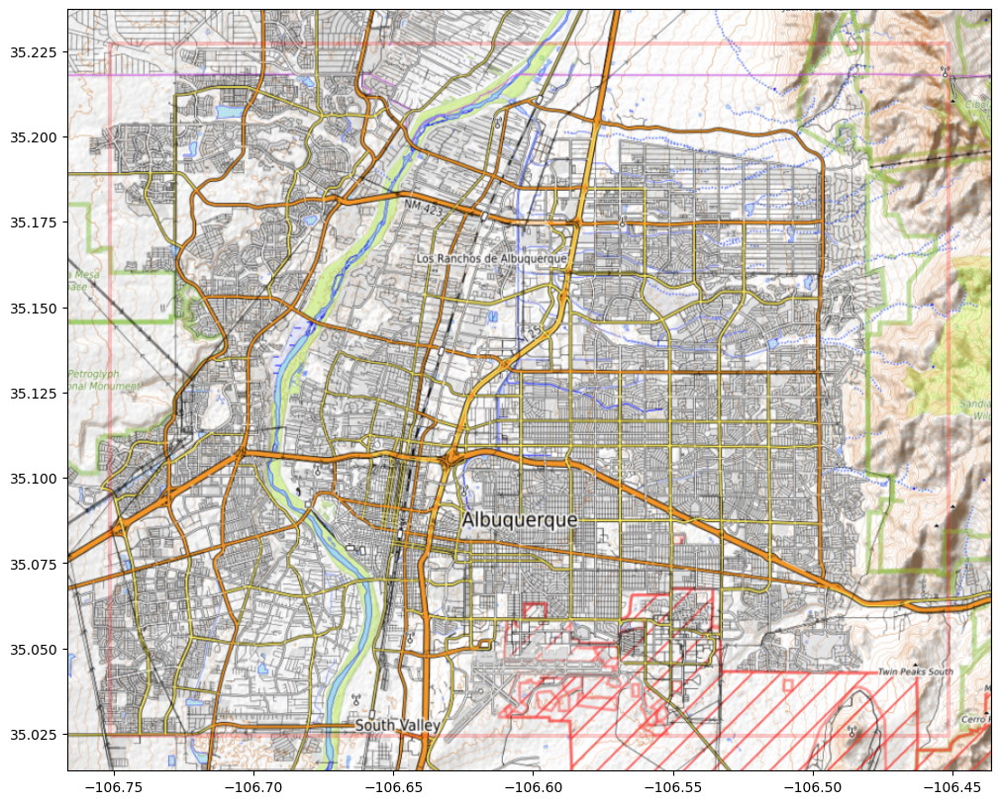

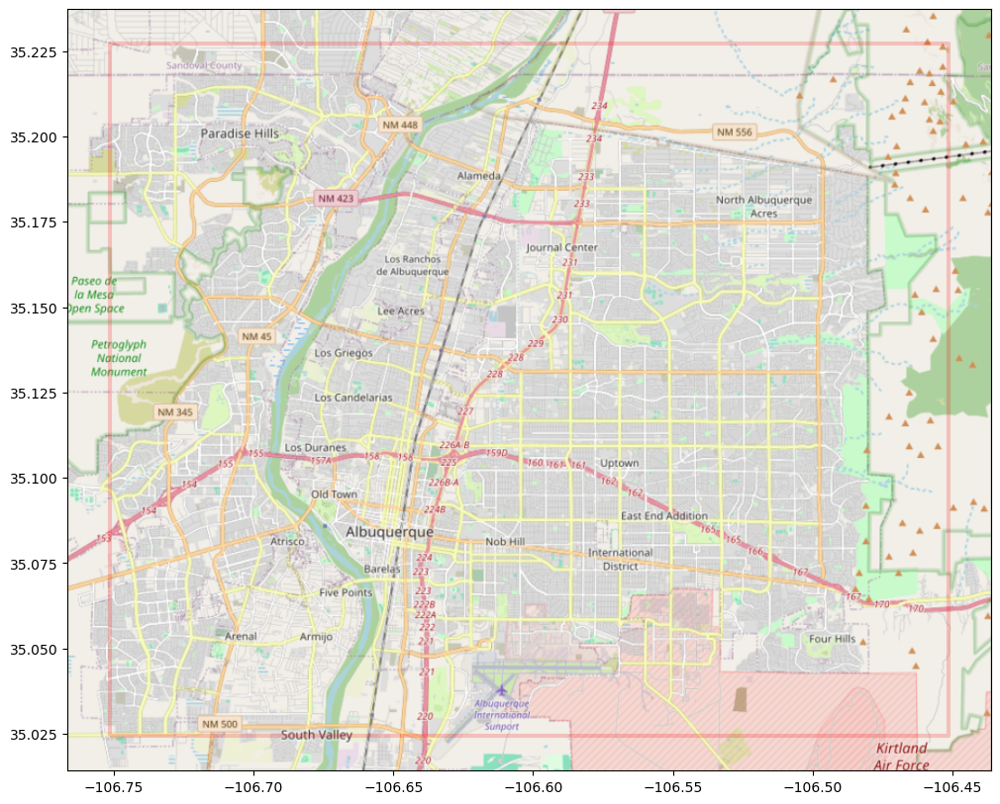

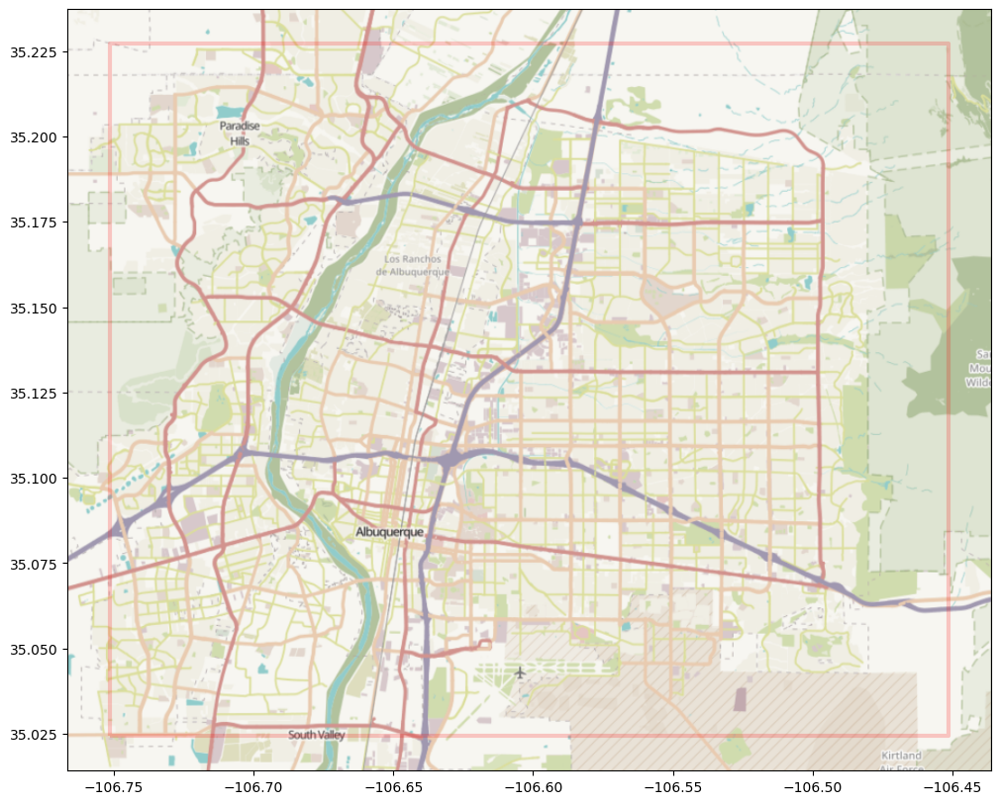

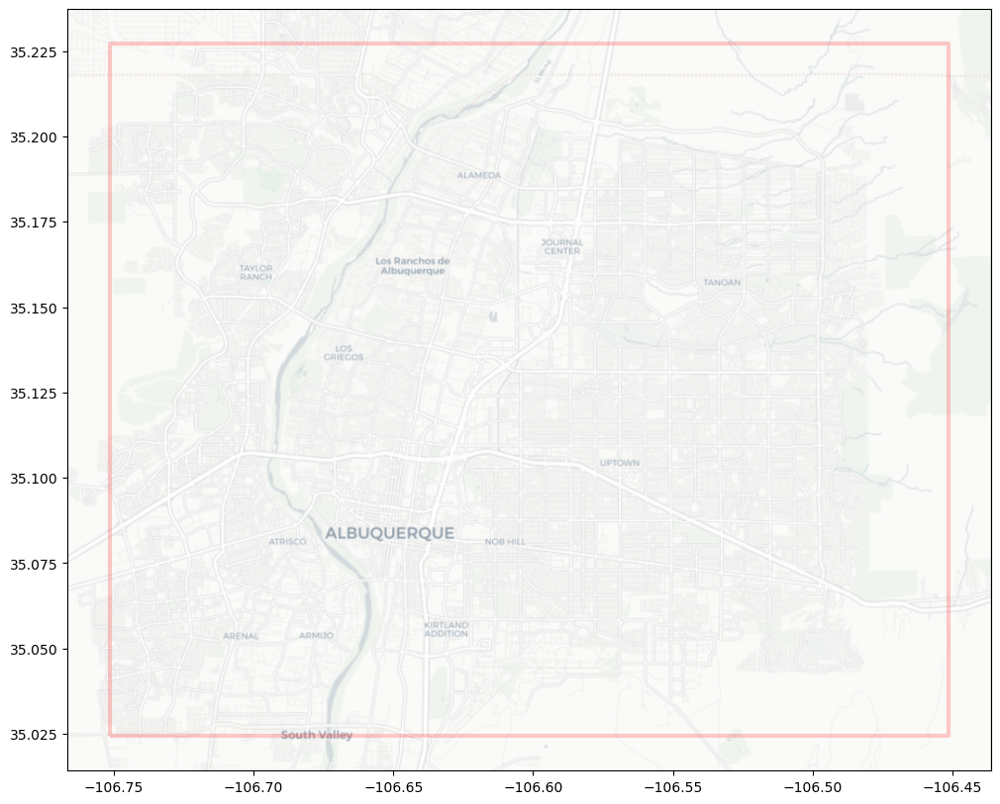

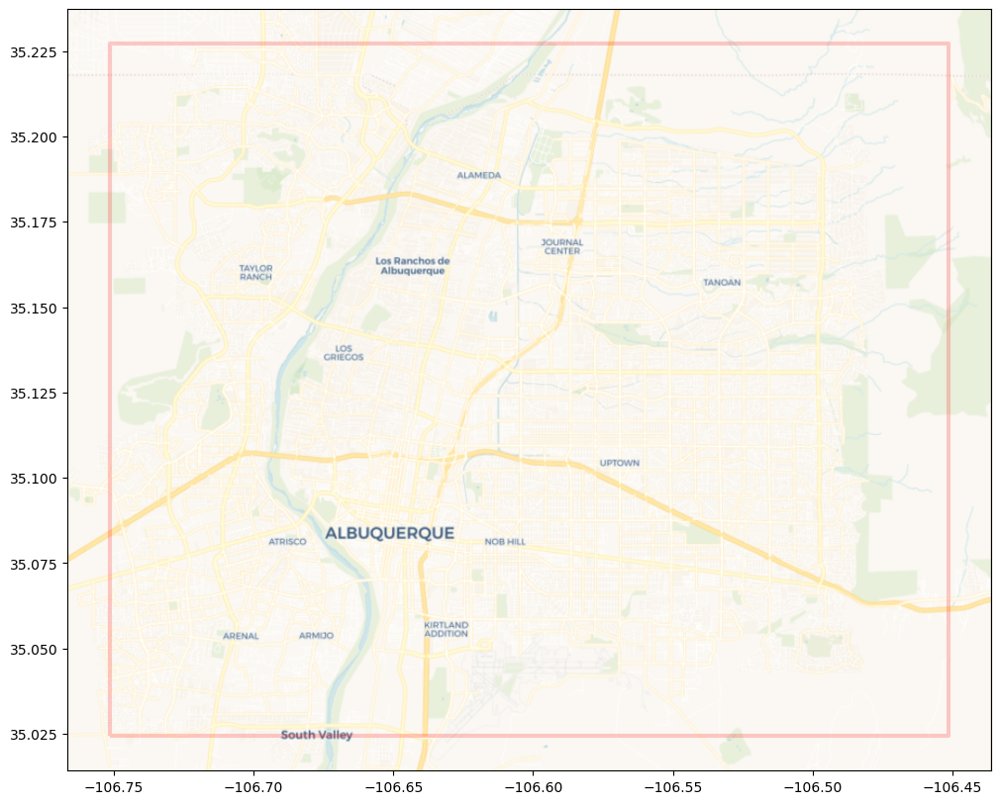

...

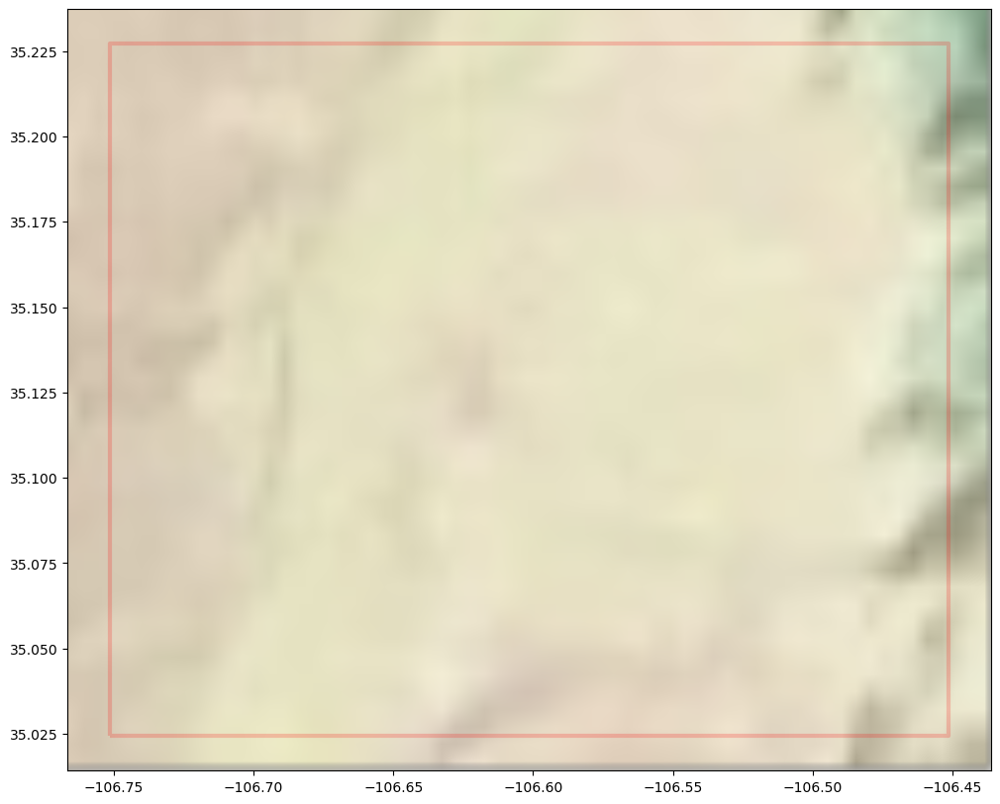

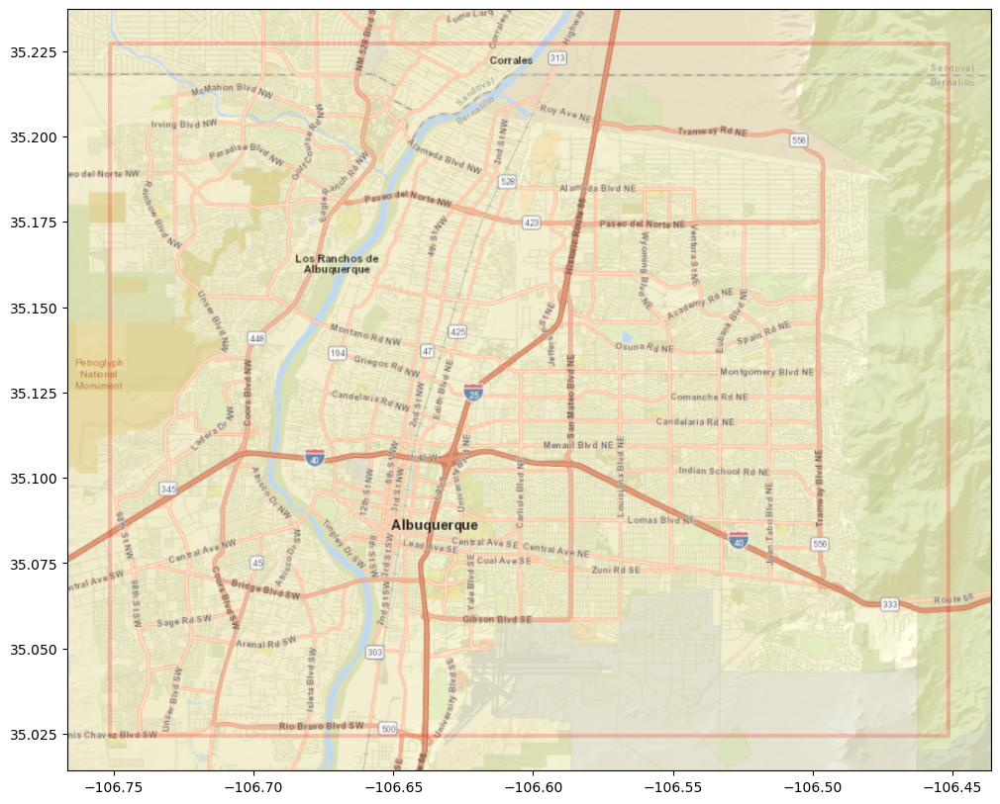

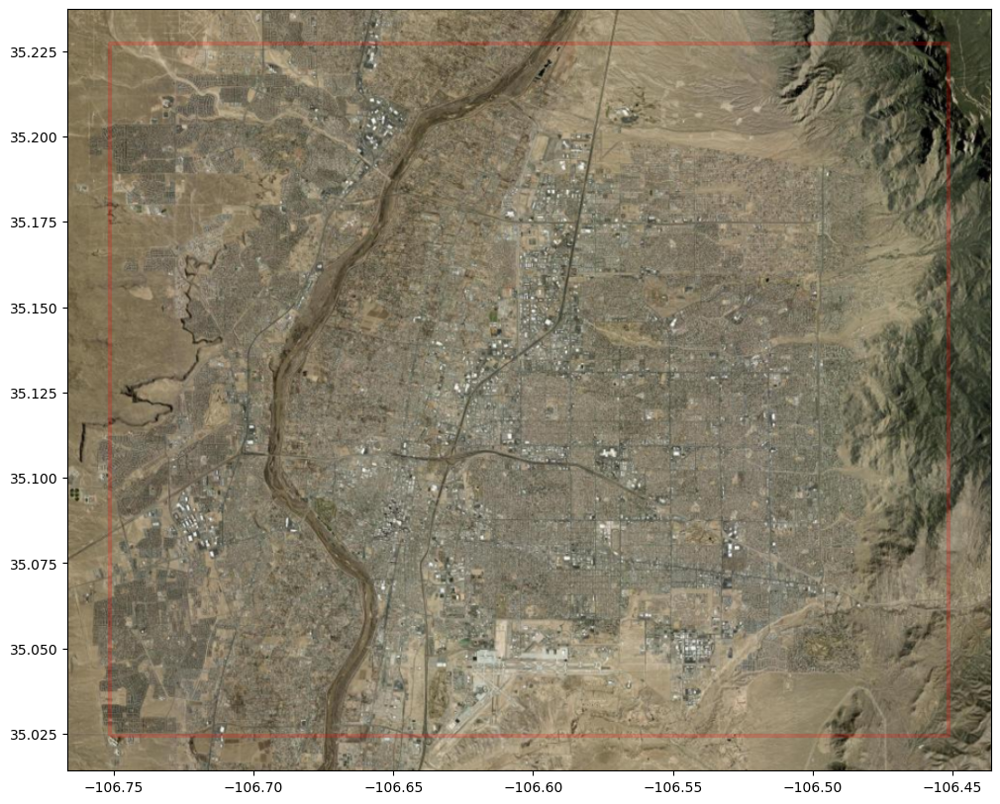

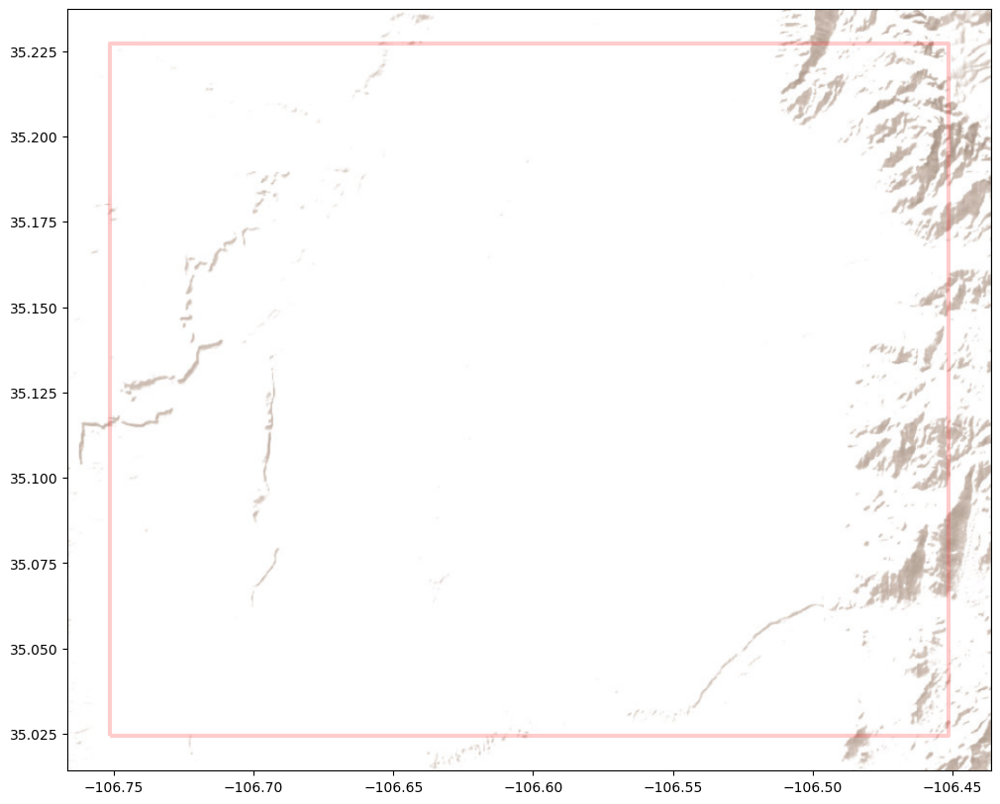

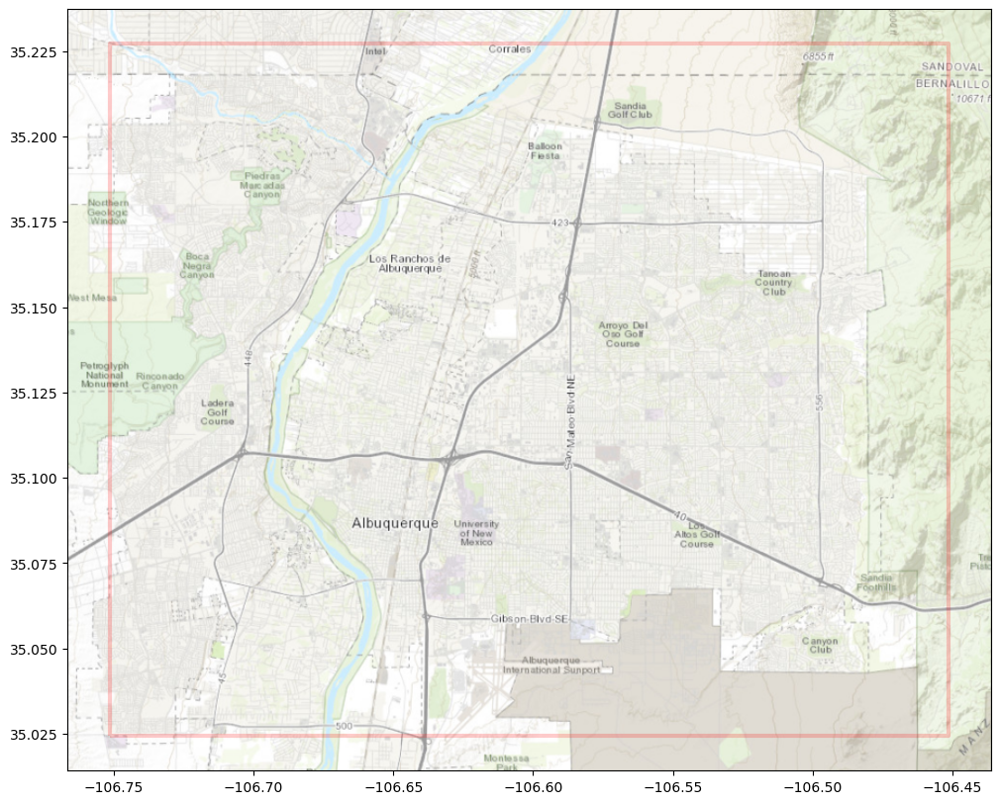

In [46]:
for _, path in providers:
    ax = abq.plot(alpha=0.2, 
                  facecolor="none", lw=3, 
                  edgecolor='red')
    ctx.add_basemap(ax, source=path, crs=abq.crs)

In [51]:
VTR_BB_COORDS = [
         (-106.741404, 35.132374),
         (-106.741404, 35.177111),
         (-106.671340, 35.177111),
         (-106.671340, 35.132374),
]

poly = Polygon(VTR_BB_COORDS)

vtr = gpd.GeoDataFrame(geometry=[poly])

vtr = vtr.set_crs(CRS.from_epsg(4269))
vtr.to_file("../../data/local/vtr_shp.gpkg", 
            driver='GPKG', layer='base')
vtr.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [20]:
west, south, east, north = bbox = vtr.total_bounds
bbox

array([-106.741404,   35.132374, -106.67134 ,   35.177111])

In [15]:
vtr.to_file("../../data/shp/vtr_shp.gpkg", driver='GPKG', layer='base')

In [41]:
vtr_providers = [
    (ctx.providers.OpenTopoMap, "../../images/vtr_oto.tif"),
    (ctx.providers.OpenStreetMap.Mapnik, "../../images/vtr_osm_mn.tif"), 
    (ctx.providers.OpenStreetMap.HOT, "../../images/vtr_hot.tif"),
    (ctx.providers.CartoDB.Positron, "../../images/vtr_cdbp.tif"),
    (ctx.providers.CartoDB.Voyager, "../../images/vtr_cdbv.tif"),
    (ctx.providers.Esri.NatGeoWorldMap, "../../images/vtr_ngwm.tif"),
    (ctx.providers.Esri.WorldPhysical, "../../images/vtr_esri_wp.tif"),
    (ctx.providers.Esri.WorldStreetMap, "../../images/vtr_esri_ws.tif"),
    (ctx.providers.Esri.WorldImagery, "../../images/vtr_esri_wi.tif"),
    (ctx.providers.Esri.WorldTerrain, "../../images/vtr_esri_wt.tif"),
    (ctx.providers.Esri.WorldTopoMap, "../../images/vtr_esri_wtopo.tif"),
]

In [23]:
for provider, path in vtr_providers:
    img, ext = ctx.bounds2raster(west,
                                 south,
                                 east,
                                 north,
                                 path,
                                 ll=True, 
                                 source=provider
                                )

/home/biscotty/ProjectLocal/VTR/venvDir/lib/python3.12/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 14 is not valid for the current tile provider (valid zooms: 0 - 8).
  warnings.warn(msg)
/home/biscotty/ProjectLocal/VTR/venvDir/lib/python3.12/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 14 is not valid for the current tile provider (valid zooms: 0 - 13).
  warnings.warn(msg)


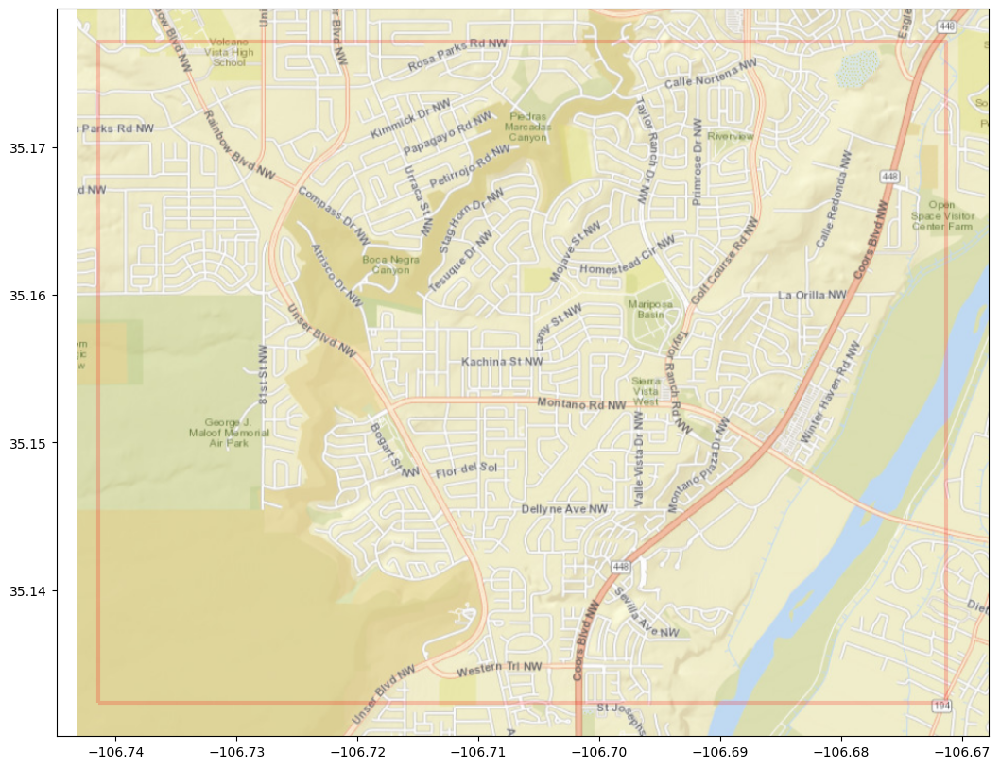

In [35]:
ax = vtr.plot(figsize=(20,10), alpha=0.2, 
              facecolor="none", lw=3, 
              edgecolor='red')
ctx.add_basemap(ax, source="../../images/vtr_esri_ws.tif", crs=vtr.crs)

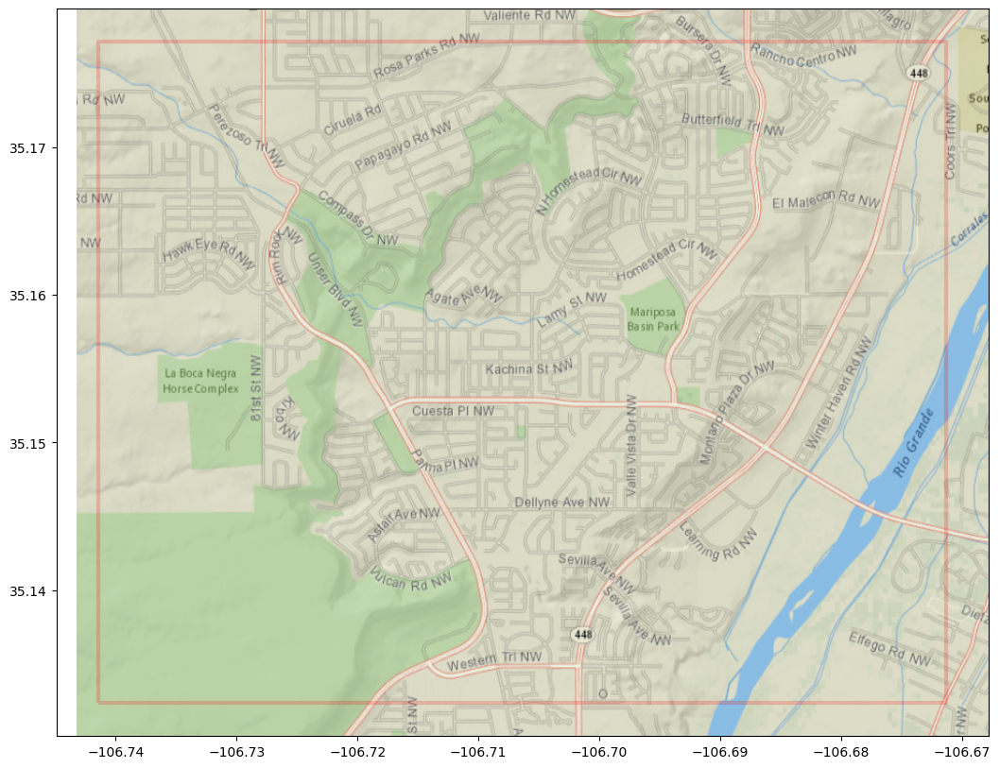

In [39]:
ax = vtr.plot(figsize=(20,10), alpha=0.2, 
              facecolor="none", lw=3, 
              edgecolor='red')
ctx.add_basemap(ax, source="../../images/vtr_ngwm.tif", crs=vtr.crs)

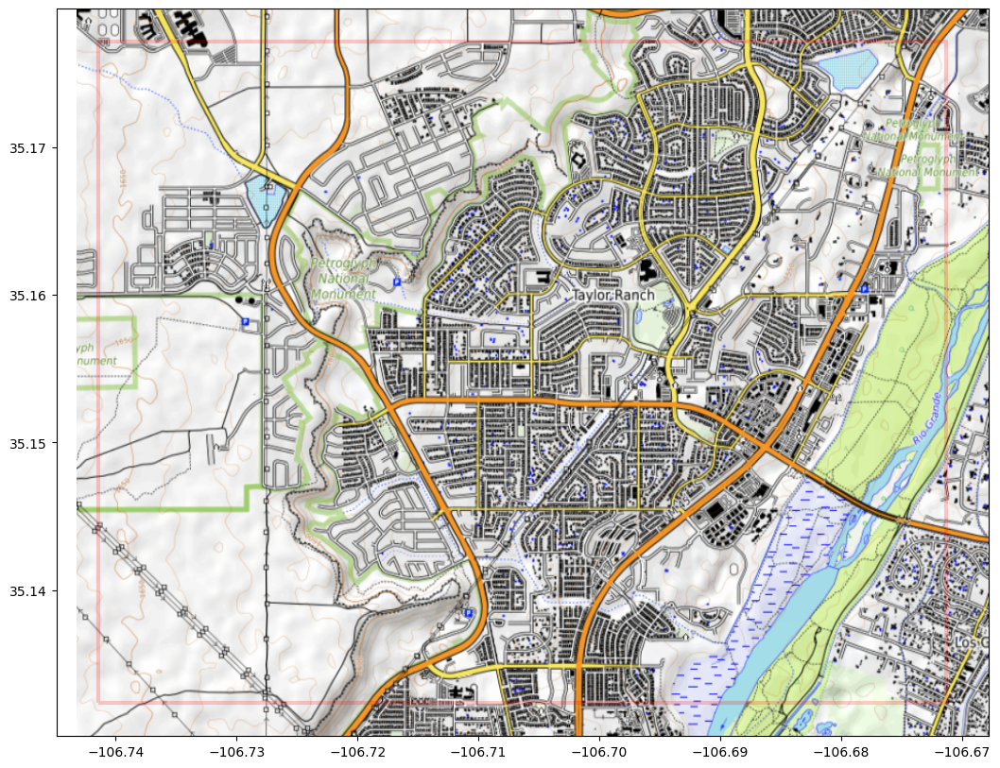

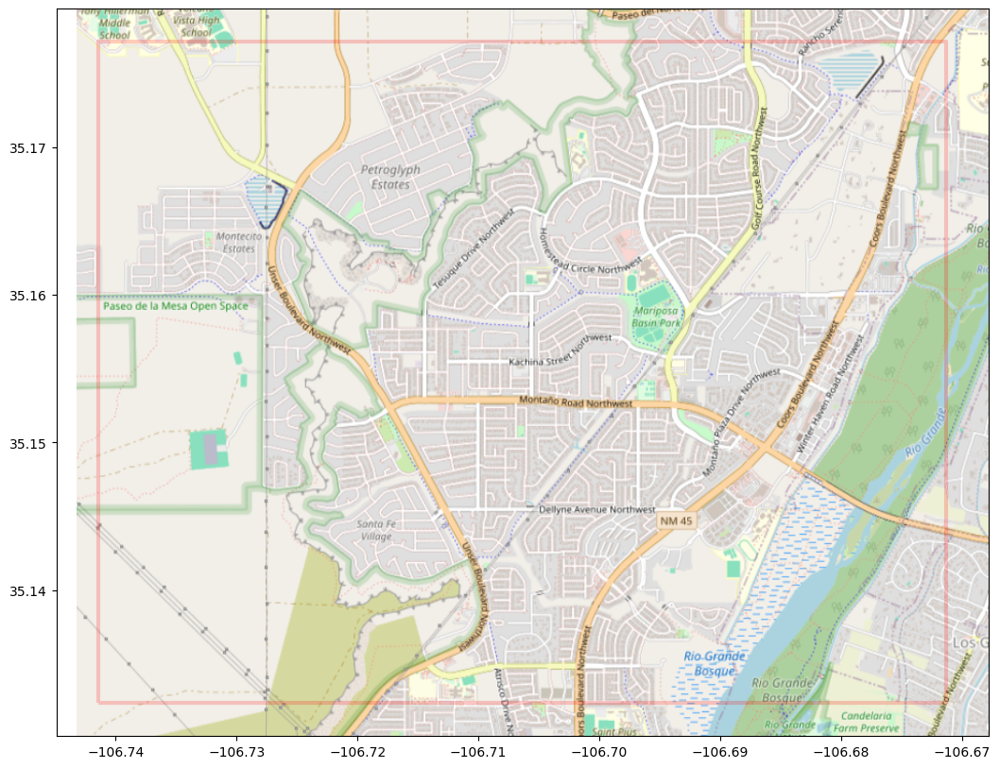

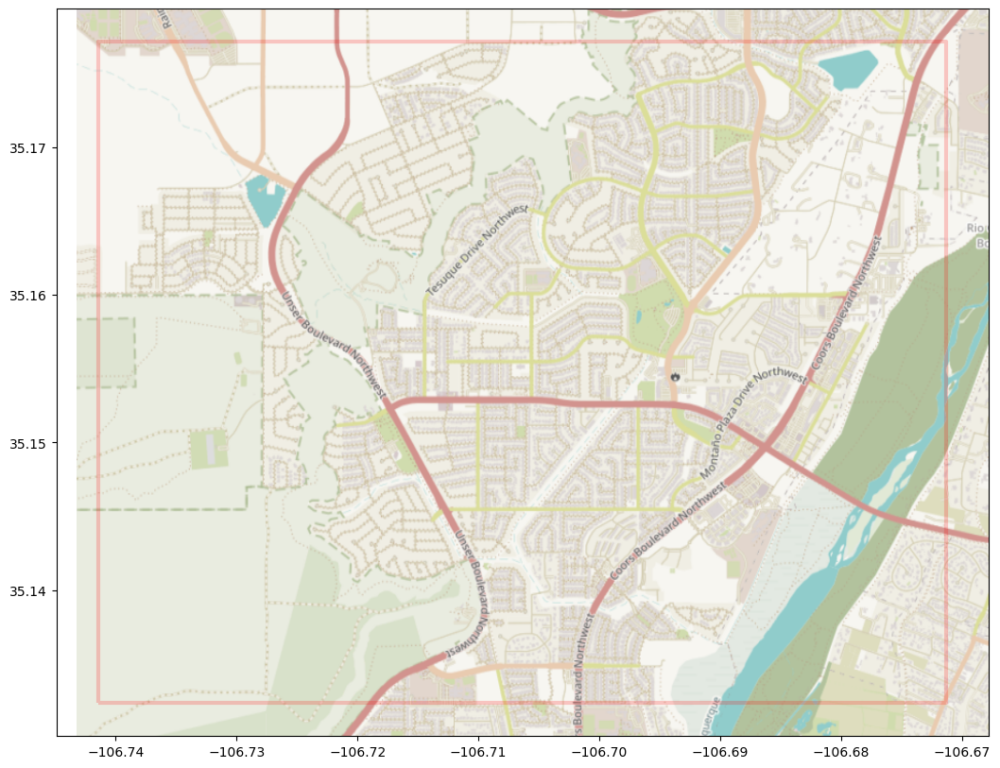

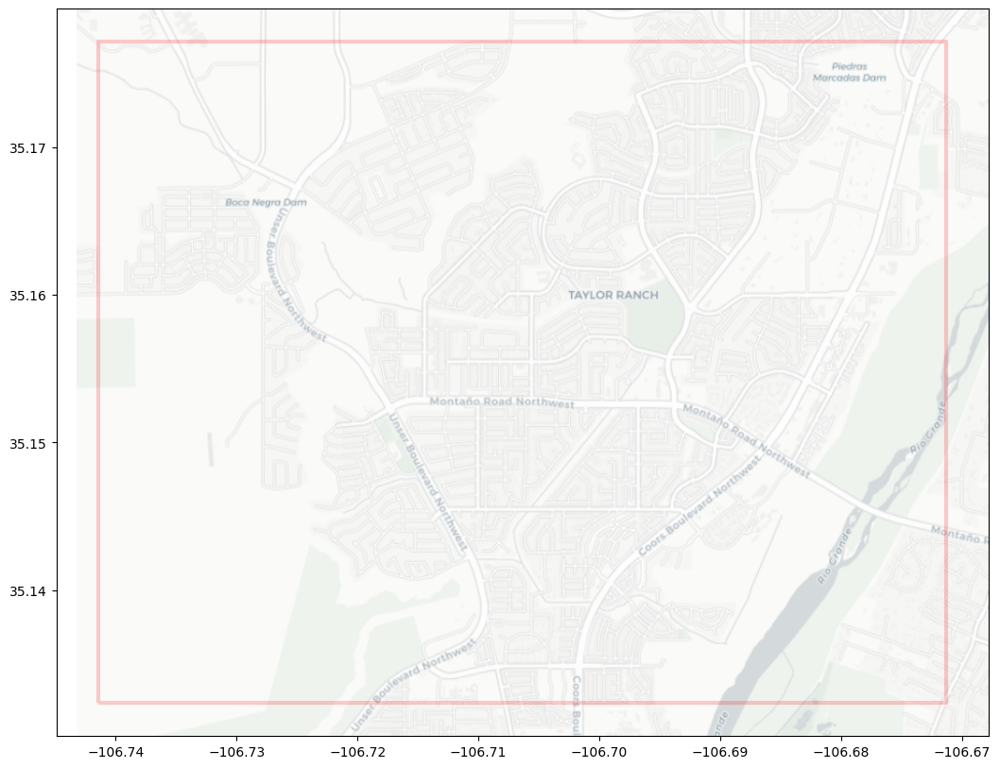

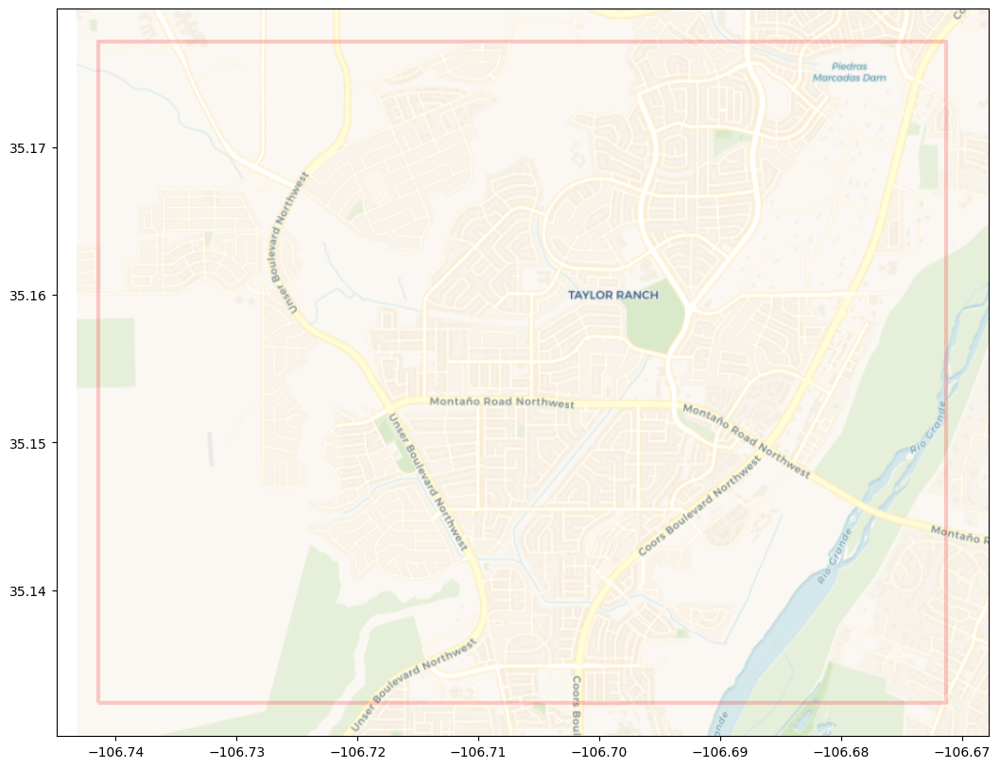

...

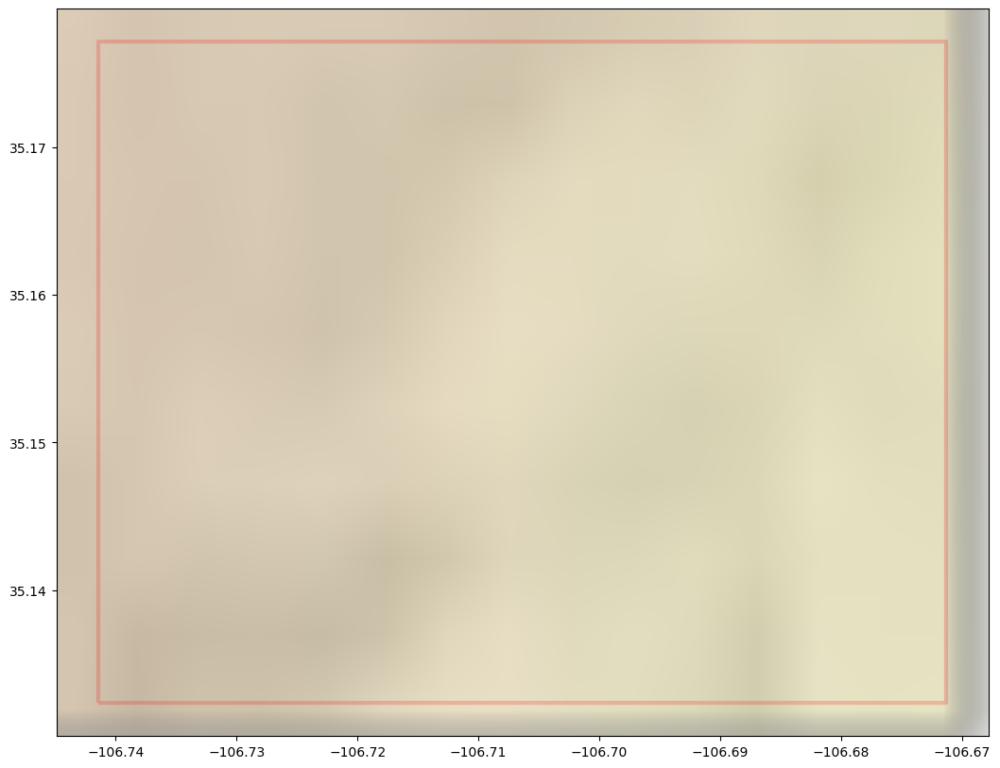

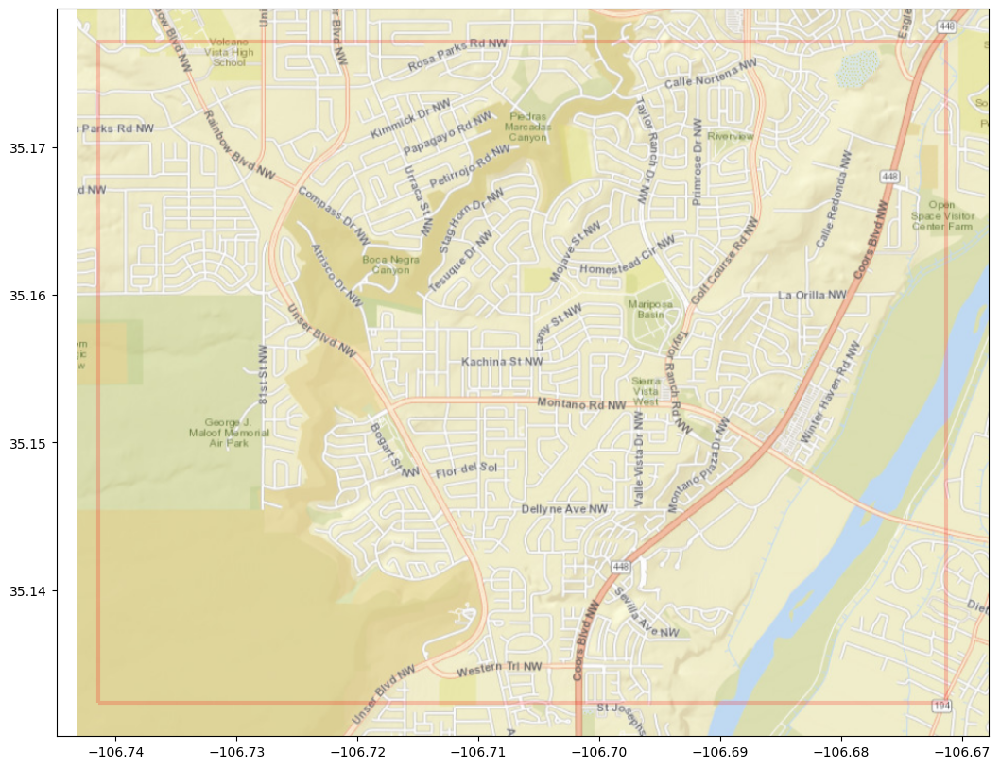

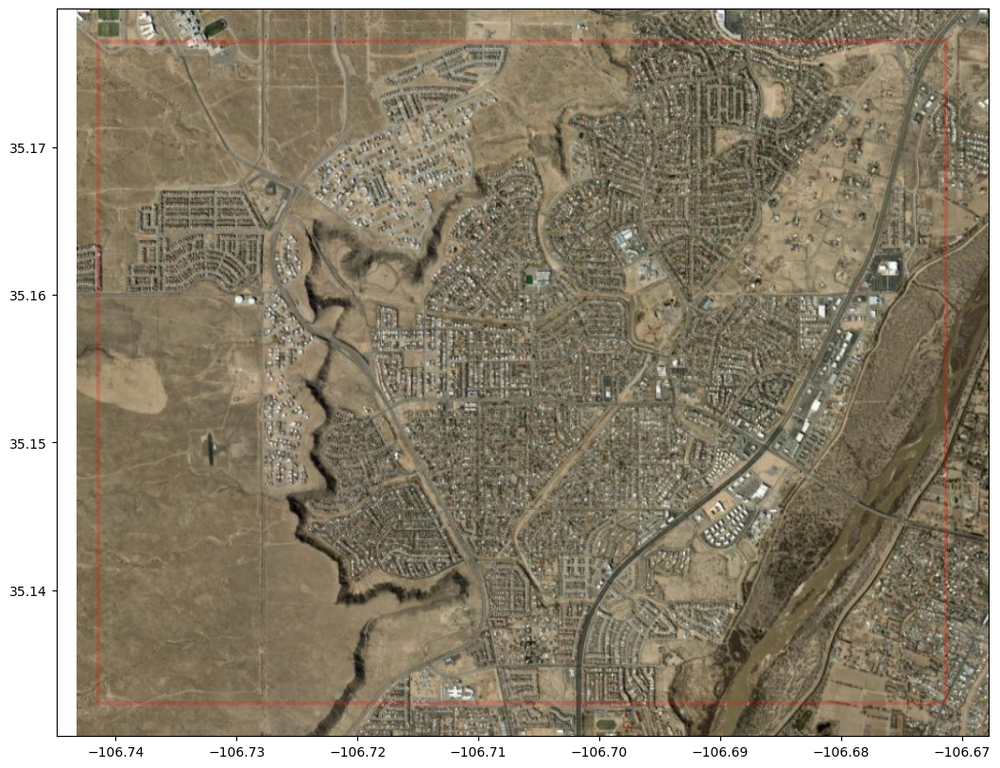

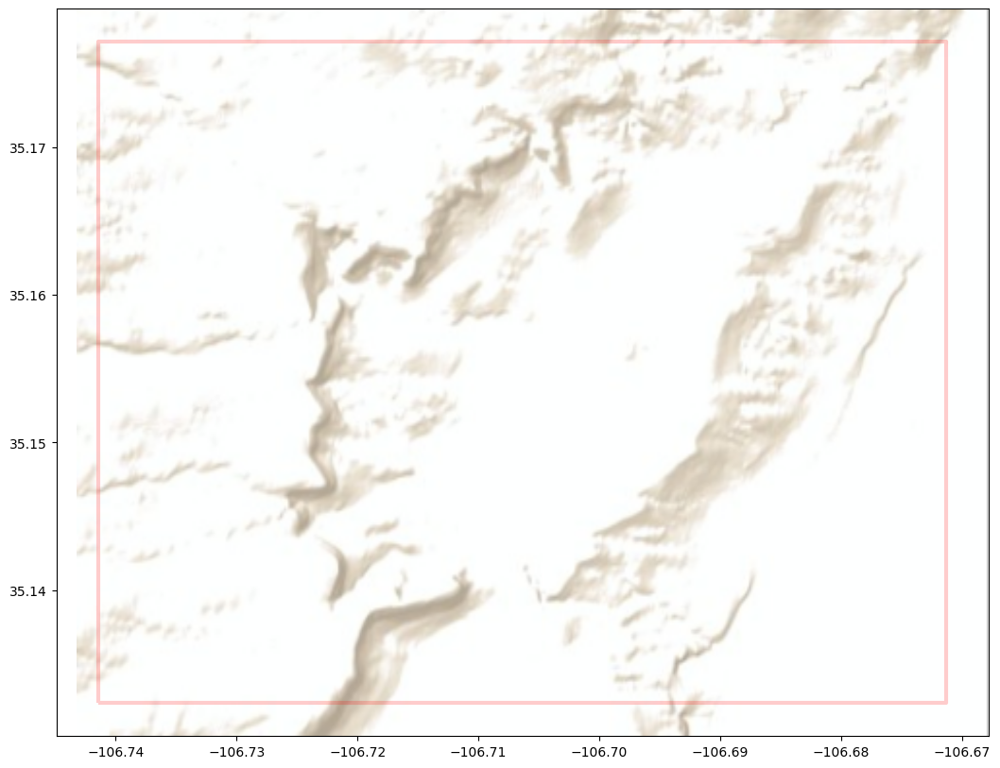

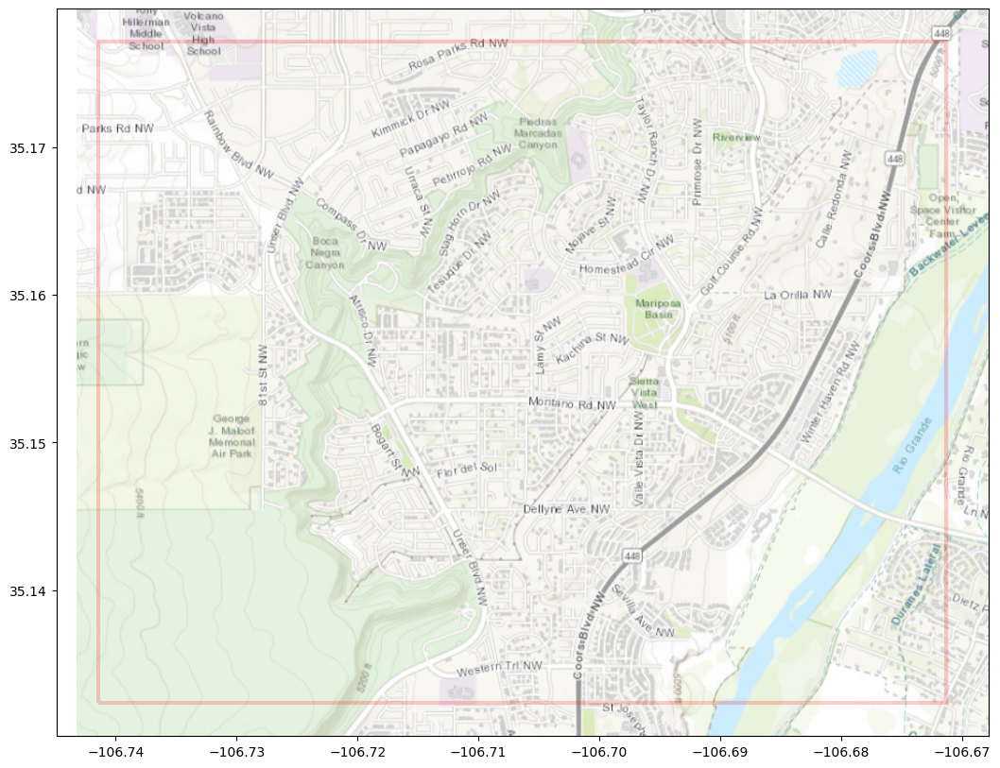

In [40]:
for _, path in vtr_providers:
    ax = vtr.plot(alpha=0.2, 
                  facecolor="none", lw=3, 
                  edgecolor='red')
    ctx.add_basemap(ax, source=path, crs=vtr.crs)